In [4]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf

2026-01-12 17:07:54.020892: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1768237674.217265      55 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1768237674.277157      55 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1768237674.755789      55 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1768237674.755849      55 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1768237674.755853      55 computation_placer.cc:177] computation placer alr

In [5]:
IMG_SIZE = 128
DATASET_PATH = "/kaggle/input/airbus-ship-detection"
DATASAVE_PATH = "/kaggle/working"

In [8]:
def rle_decode(rle, shape=(768, 768)):
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    s = list(map(int, rle.split()))
    starts, lengths = s[0::2], s[1::2]
    starts = np.array(starts) - 1
    ends = starts + lengths
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape, order='F')

def preprocess_image_mask(image_path, mask_rles, img_size=IMG_SIZE):
    # Image
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)  # [0,1]
    img = tf.image.resize(img, [img_size, img_size])
    # Mask
    mask = np.zeros((768, 768), dtype=np.float32)
    for rle in mask_rles:
        if pd.notna(rle):
            mask += rle_decode(rle)
    mask = np.clip(mask, 0, 1)
    mask = tf.image.resize(mask[..., None], [img_size, img_size], method='nearest')

    return img, mask

In [9]:
#Mennyi kép legyen benne?
SAMPLE_SIZE = 2500

In [10]:
mask_df = pd.read_csv(DATASET_PATH+"/train_ship_segmentations_v2.csv")
grouped = mask_df.groupby("ImageId")

image_files = sorted(os.listdir(DATASET_PATH+"/train_v2"))[:SAMPLE_SIZE]
image_paths = [np.array(os.path.join(DATASET_PATH+"/train_v2", f)) for f in image_files]

rle_lists = [grouped.get_group(f)["EncodedPixels"].values if f in grouped.groups else [] for f in image_files]
images = []
masks = []
counts = []
for index in range(len(image_paths)):
    image, mask = preprocess_image_mask(image_paths[index], rle_lists[index])
    images.append(image)
    masks.append(mask)
    counts.append(np.sum(pd.notna(rle_lists[index])))

dataset = tf.data.Dataset.from_tensor_slices((images, masks, counts))


I0000 00:00:1768237820.403027      55 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1768237820.406892      55 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


In [56]:
def balance_dataset(dataset):
    positive = dataset.filter(lambda img, mask, count: count > 0)
    negative = dataset.filter(lambda img, mask, count: count == 0)

    return tf.data.Dataset.sample_from_datasets(
        [positive, negative],
        weights=[0.5, 0.5]
    )

#Kidobjuk a számláló attribútumot
def drop_count(img, mask, count):
    return img, mask

train_dataset, test_dataset = tf.keras.utils.split_dataset(
    dataset, left_size=0.8, shuffle=True
)

train_dataset, val_dataset = tf.keras.utils.split_dataset(
    train_dataset, left_size=0.8, shuffle=True
)

train_dataset = balance_dataset(train_dataset).map(drop_count)
val_dataset   = balance_dataset(val_dataset).map(drop_count)
test_dataset  = balance_dataset(test_dataset).map(drop_count)

train_dataset.save(f"{DATASAVE_PATH}/dataset/train")
val_dataset.save(f"{DATASAVE_PATH}/dataset/val")
test_dataset.save(f"{DATASAVE_PATH}/dataset/test")

In [57]:
BATCH_SIZE = 32
train_dataset = train_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.batch(BATCH_SIZE)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [29]:
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from keras import layers, Model
import tensorflow as tf
from tensorflow.keras import backend as K
from keras.losses import BinaryCrossentropy


In [30]:
def conv_block(x, filters):
    x = layers.Conv2D(filters, 3, padding="same", activation="relu")(x)
    x = layers.Conv2D(filters, 3, padding="same", activation="relu")(x)
    return x


def encoder_block(x, filters):
    f = conv_block(x, filters)
    p = layers.MaxPooling2D((2,2))(f)
    return f, p


def decoder_block(x, skip, filters):
    x = layers.UpSampling2D((2,2))(x)
    x = layers.Concatenate()([x, skip])
    x = conv_block(x, filters)
    return x



def build_unet():
    inputs = layers.Input((128, 128, 3))

    # Encoder
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)

    # Bottleneck
    b = conv_block(p4, 1024)

    # Decoder
    d1 = decoder_block(b, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    outputs = layers.Conv2D(1, 1, activation="sigmoid")(d4)

    return Model(inputs, outputs)

In [35]:
import tensorflow as tf

def iou_metric(y_true, y_pred, smooth=1e-6):
    """
    Jaccard / IoU:
    IoU = intersection / union
    """
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred > 0.5, tf.float32)

    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
    union = tf.reduce_sum(y_true + y_pred, axis=[1,2,3]) - intersection

    iou = (intersection + smooth) / (union + smooth)
    return tf.reduce_mean(iou)


def dice_coef(y_true, y_pred, smooth=1e-6):
    """
    Dice Score: 2 * TP / (2 * TP + FP + FN)
    """
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred > 0.5, tf.float32)

    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
    union = tf.reduce_sum(y_true + y_pred, axis=[1,2,3])

    return tf.reduce_mean((2 * intersection + smooth) / (union + smooth))


def dice_loss(y_true, y_pred, smooth=1e-6):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)

    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
    union = tf.reduce_sum(y_true + y_pred, axis=[1,2,3])

    dice = (2. * intersection + smooth) / (union + smooth)
    return 1 - tf.reduce_mean(dice)

def tversky_loss(y_true, y_pred, alpha=0.7, beta=0.3, smooth=1e-6):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)

    TP = tf.reduce_sum(y_true * y_pred, axis=[1,2,3])
    FN = tf.reduce_sum(y_true * (1 - y_pred), axis=[1,2,3])
    FP = tf.reduce_sum((1 - y_true) * y_pred, axis=[1,2,3])

    tversky = (TP + smooth) / (TP + alpha * FN + beta * FP + smooth)
    return 1 - tf.reduce_mean(tversky)

def bce_tversky_loss(y_true, y_pred):
    bce = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    tv  = tversky_loss(y_true, y_pred)
    return 0.5 * bce + 0.5 * tv



In [41]:
model = build_unet()
model.summary()

model.compile(
    optimizer="adam",
    loss="binary_crossentropy",
    metrics=[iou_metric, dice_coef]
)


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_19 (Conv2D)  │ (None, 128, 128,  │      1,792 │ input_layer_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_20 (Conv2D)  │ (None, 128, 128,  │     36,928 │ conv2d_19[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 64, 64,    │          0 │ conv2d_20[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_21 (Conv2D)  │ (None, 64, 64,    │     73,856 │ max_pooling2d_4[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 64, 64,    │    147,584 │ conv2d_21[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 32, 32,    │          0 │ conv2d_22[0][0]   │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 32, 32,    │    295,168 │ max_pooling2d_5[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 32, 32,    │    590,080 │ conv2d_23[0][0]   │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 16, 16,    │          0 │ conv2d_24[0][0]   │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 16, 16,    │  1,180,160 │ max_pooling2d_6[… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_26 (Conv2D)  │ (None, 16, 16,    │  2,359,808 │ conv2d_25[0][0]   │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_7     │ (None, 8, 8, 512) │          0 │ conv2d_26[0][0]   │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_27 (Conv2D)  │ (None, 8, 8,      │  4,719,616 │ max_pooling2d_7[… │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_28 (Conv2D)  │ (None, 8, 8,      │  9,438,208 │ conv2d_27[0][0]   │
│                     │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ up_sampling2d_4     │ (None, 16, 16,    │          0 │ conv2d_28[0][0]   │
│ (UpSampling2D)      │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_4       │ (None, 16, 16,    │          0 │ up_sampling2d_4[

 Total params: 31,378,945 (119.70 MB)

 Trainable params: 31,378,945 (119.70 MB)

 Non-trainable params: 0 (0.00 B)

In [42]:
checkpoint = ModelCheckpoint(
    "unet_airbus_best.keras",
    monitor="val_loss",
    save_best_only=True,
    verbose=1
)

reduce_lr = ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.5,
    patience=2,   # ⬅ gyorsabb reagálás
    min_lr=1e-6,
    verbose=1
)

early_stop = EarlyStopping(
    monitor="val_loss",
    patience=10,  # ⬅ kicsit több mozgástér
    restore_best_weights=True,
    verbose=1
)

callbacks = [checkpoint, reduce_lr, early_stop]


In [43]:
EPOCHS = 100

history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=EPOCHS,
    callbacks=callbacks,
    verbose=1
)


Epoch 1/100
     50/Unknown 31s 440ms/step - dice_coef: 0.5828 - iou_metric: 0.5822 - loss: 0.5825
Epoch 1: val_loss improved from inf to 24.85569, saving model to unet_airbus_best.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 37s 560ms/step - dice_coef: 0.5868 - iou_metric: 0.5862 - loss: 0.5754 - val_dice_coef: 0.7909 - val_iou_metric: 0.7909 - val_loss: 24.8557 - learning_rate: 0.0010
Epoch 2/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step - dice_coef: 0.6369 - iou_metric: 0.6369 - loss: 2.9548
Epoch 2: val_loss improved from 24.85569 to 0.91500, saving model to unet_airbus_best.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 25s 502ms/step - dice_coef: 0.6401 - iou_metric: 0.6401 - loss: 2.9107 - val_dice_coef: 0.7909 - val_iou_metric: 0.7909 - val_loss: 0.9150 - learning_rate: 0.0010
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step - dice_coef: 0.6369 - iou_metric: 0.6369 - loss: 0.1773
Epoch 3: val_loss improved from 0.91500 to 0.10704, saving model to unet_airbus_best.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 24s 

## DEMO

In [65]:
from tensorflow.keras.models import load_model
model = load_model(
    "unet_airbus_best.keras",
    compile=False
)


In [67]:
import numpy as np
import matplotlib.pyplot as plt
import random

def show_predictions_random_batch(model, val_dataset, count=30, threshold=0.5):
    shown = 0

    for X, y in val_dataset:   # <-- itt jön a fix
        batch_size = X.shape[0]

        indices = list(range(batch_size))
        random.shuffle(indices)

        for i in indices:
            if shown >= count:
                return

            preds = model.predict(X[i][np.newaxis, ...], verbose=0)
            #pred_mask = (preds[0] > threshold).astype(np.float32)
            pred_mask = preds.astype(np.float32)

            plt.figure(figsize=(12, 4))

            # Input image
            plt.subplot(1, 3, 1)
            plt.imshow(X[i])
            plt.title("Input image")
            plt.axis("off")

            # Ground truth
            plt.subplot(1, 3, 2)
            plt.imshow(np.squeeze(y[i]), cmap="gray")
            plt.title("Ground truth mask")
            plt.axis("off")

            # Prediction
            plt.subplot(1, 3, 3)
            plt.imshow(np.squeeze(pred_mask), cmap="gray")
            plt.title("Predicted mask")
            plt.axis("off")

            plt.tight_layout()
            plt.show()

            shown += 1


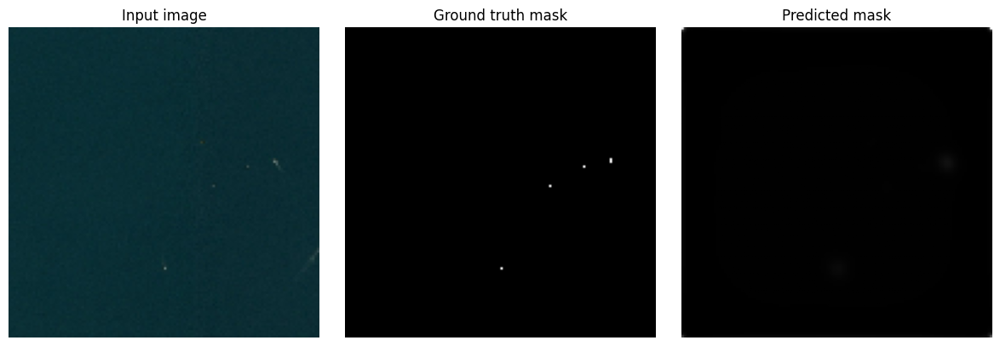

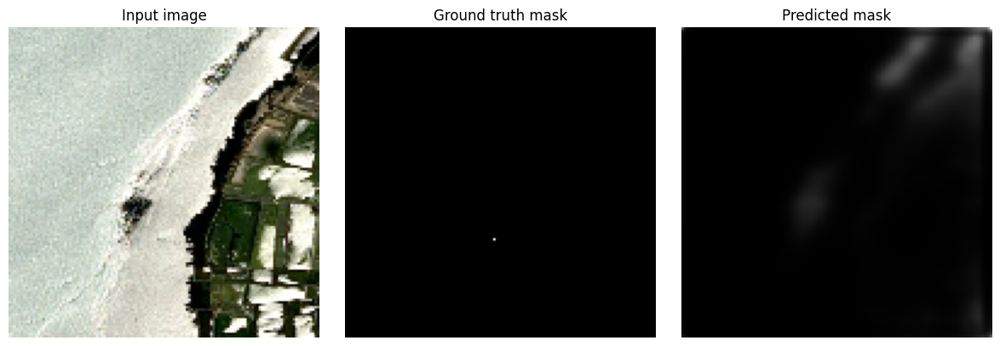

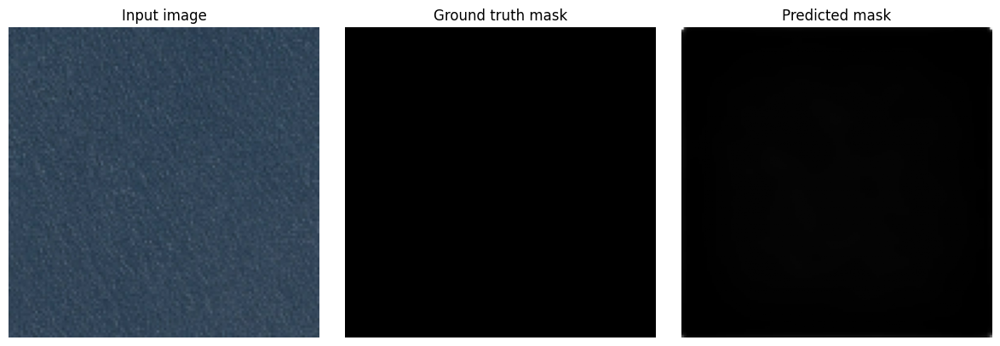

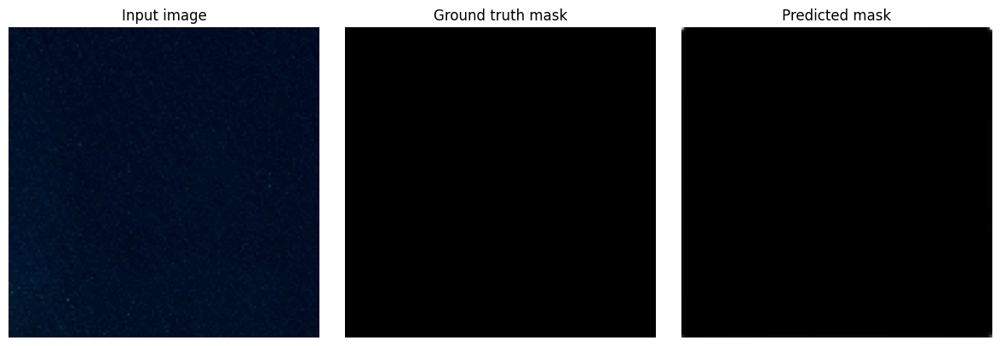

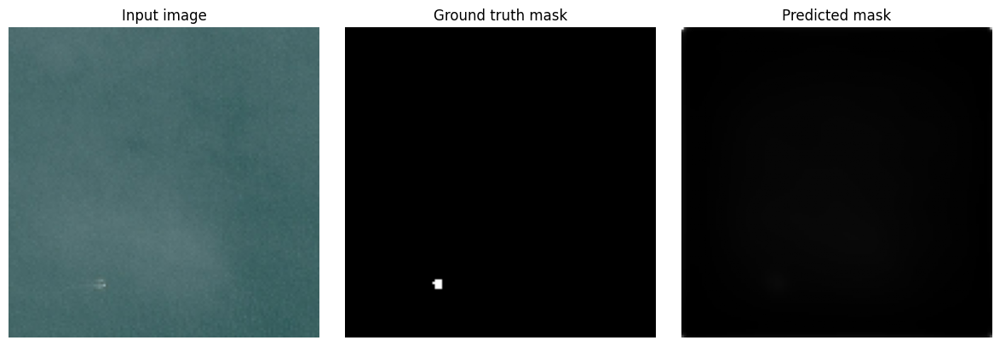

...

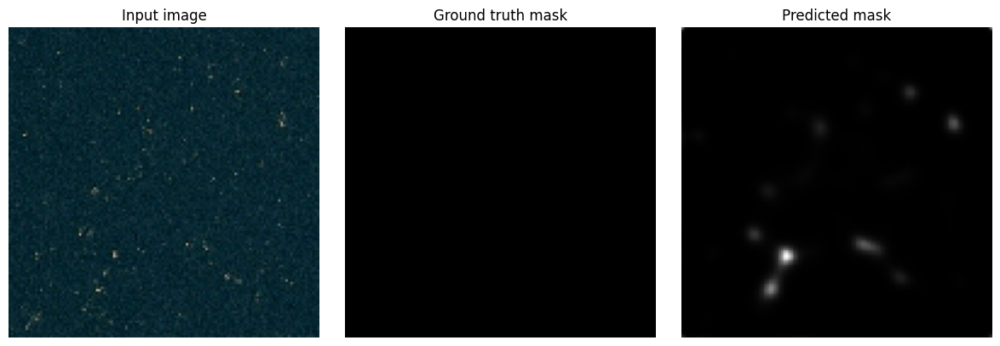

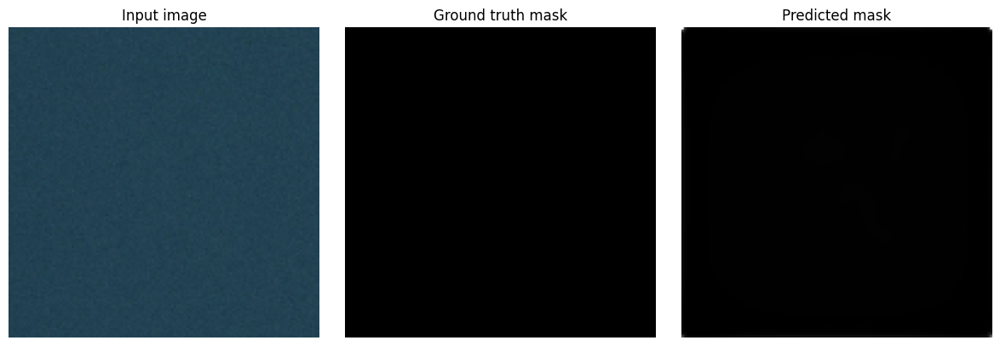

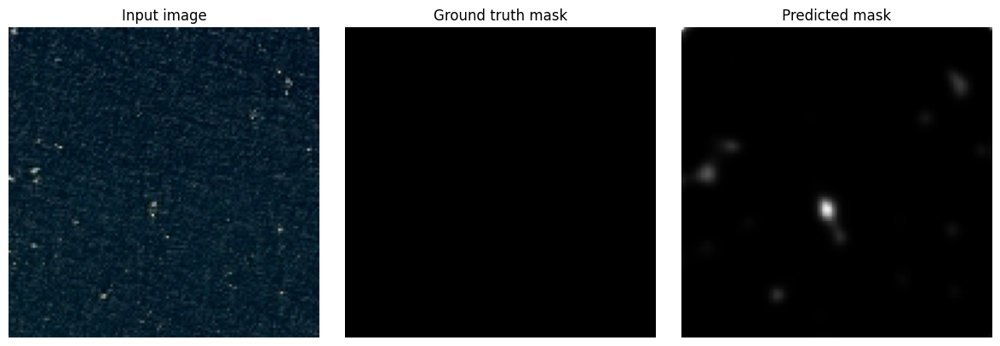

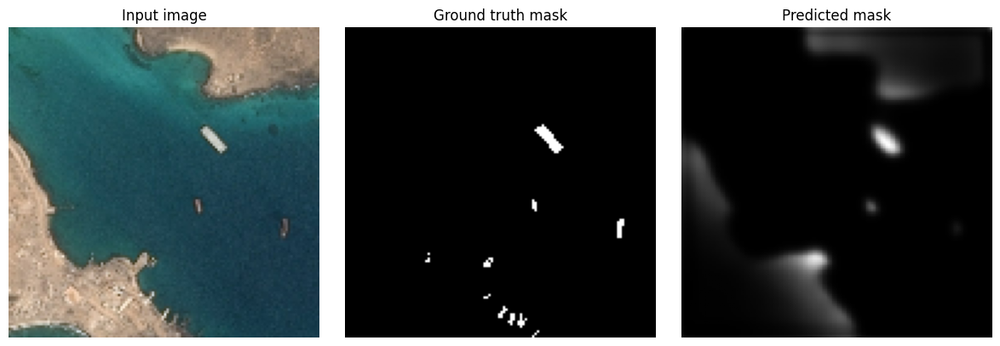

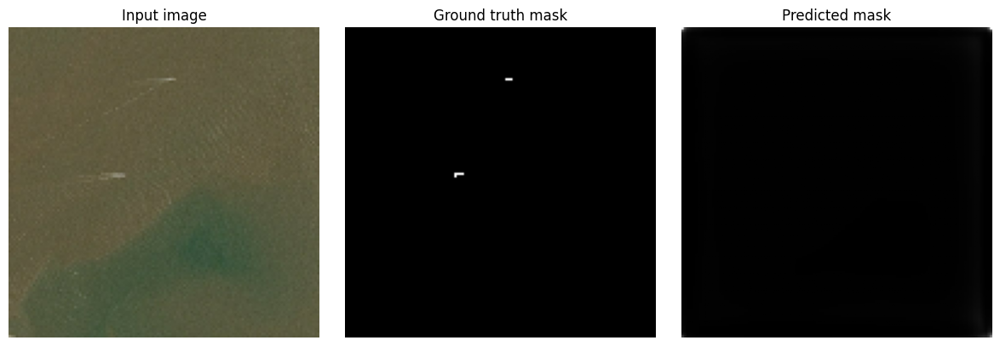

In [68]:
show_predictions_random_batch(model, val_dataset, count=100)


In [60]:
import cv2
def iou(mask1, mask2):
    """Compute IoU between two masks (handles numpy arrays or tensors).

    Args:
        mask1, mask2: Binary masks as numpy arrays or tensors.

    Returns:
        IoU float in [0,1]. Returns 0.0 when union is zero.
    """
    mask1 = mask1.astype(bool)
    mask2 = mask2.astype(bool)

    inter = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    if union == 0:
        return 0.0
    return inter / union


def extract_objects(binary_mask):
    """Extract connected object masks from a binary mask tensor/array.

    Converts inputs to numpy, thresholds to binary, finds connected components
    and returns a list of boolean masks for each object (excluding background).

    Args:
        binary_mask: Tensor or numpy array representing a mask (possibly batched/channeled).

    Returns:
        list of np.ndarray: Boolean masks for each connected object.
    """
    binary_mask = tf.cast(binary_mask, tf.uint8)
    binary_mask = binary_mask.numpy()
    if tf.is_tensor(binary_mask):
        binary_mask = binary_mask.numpy()

    # 2. Float -> binary
    binary_mask = (binary_mask > 0.5)

    # 3. uint8
    binary_mask = binary_mask.astype(np.uint8)

    # 4. Remove batch and channel dims
    binary_mask = np.squeeze(binary_mask)
    num_labels, labels = cv2.connectedComponents(binary_mask)

    objects = []
    for label in range(1, num_labels):  # 0 = background
        obj_mask = (labels == label)
        objects.append(obj_mask)

    return objects

In [61]:
def f2_score_per_image(gt_mask, pred_mask):
    """Compute F2 score for a single image by averaging over IoU thresholds.

    The function extracts individual objects from the ground-truth and
    predicted masks, then for each IoU threshold computes TP/FP/FN and
    derives the F2 score. The returned score is the mean over thresholds.

    Args:
        gt_mask: Ground-truth mask (tensor or array).
        pred_mask: Predicted mask (tensor or array).

    Returns:
        float: Mean F2 score across thresholds.
    """
    thresholds = np.arange(0.5, 1.0, 0.05)

    gt_objects = extract_objects(gt_mask)
    pred_objects = extract_objects(pred_mask)

    # Edge cases
    if len(gt_objects) == 0 and len(pred_objects) == 0:
        return 1.0

    if len(gt_objects) == 0 and len(pred_objects) > 0:
        return 0.0

    f2_scores = []

    for t in thresholds:
        TP = 0
        FP = 0

        matched_gt = set()

        for pred_obj in pred_objects:
            best_iou = 0.0
            best_gt_idx = None

            # find the best GT match
            for i, gt_obj in enumerate(gt_objects):
                if i in matched_gt:
                    continue
                iou_val = iou(pred_obj, gt_obj)
                if iou_val > best_iou:
                    best_iou = iou_val
                    best_gt_idx = i

            if best_iou >= t and best_gt_idx is not None:
                TP += 1
                matched_gt.add(best_gt_idx)
            else:
                FP += 1

        FN = len(gt_objects) - len(matched_gt)

        beta2 = 4.0  # beta=2 => beta^2 = 4
        denom = (1 + beta2) * TP + beta2 * FN + FP
        if denom == 0:
            f2_t = 0.0
        else:
            f2_t = (1 + beta2) * TP / denom

        f2_scores.append(f2_t)

    return float(np.mean(f2_scores))


In [63]:
import numpy as np

def evaluate_dataset_competition_f2(model, test_dataset, pred_threshold=0.5):
    """Evaluate a model on a dataset using competition-style mean F2 score.

    For each image in `test_dataset`, predicts a mask, thresholds it to
    binary and computes the per-image F2 score. Returns the mean score
    across the dataset.

    Args:
        model: Trained model with a `.predict()` method.
        test_dataset: Iterable yielding batches of (X, y) where X are images and y are masks.
        pred_threshold (float): Threshold to binarize predicted probability masks.

    Returns:
        float: Mean F2 score over the dataset.
    """
    all_scores = []

    for X, y in test_dataset:
        batch_size = X.shape[0]

        # Predikció teljes batch-re (GYORSABB + BIZTOS)
        preds = model.predict(X, verbose=0)
        preds_bin = (preds > pred_threshold).astype(np.uint8)

        for i in range(batch_size):
            # GT binarizálása
            y_true = (y[i] > 0.5).numpy().astype(np.uint8)
            y_pred = preds_bin[i]

            score = f2_score_per_image(y_true, y_pred)
            all_scores.append(score)

    return float(np.mean(all_scores))


In [64]:
test_f2 = evaluate_dataset_competition_f2(model, test_dataset, pred_threshold=0.5)
print("Competition-style F2 a test seten:", test_f2)


Competition-style F2 a test seten: 0.794
